# End-to-end atomic prediction workflow for STEM

<font size = 4> This notebook is part of the <font color = 'darkorange'>Microscopy and Microanalysis 2024</font> short course <u>X-13 Automated Experiments in Electron Microscopy</u>:

*Machine Learning for Electron Microscopy: from Data Analysis to Active Experiments*

Presented by `Sergei Kalinin` and `Kevin Roccapriore`</font>


* Authored by `Kevin Roccapriore` (currently `ORNL` and future `AtomQ`)
* Much code is based off `AtomAI` created by `Maxim Ziatdinov`
* STEM image simulations achieved via `abTEM`
* Let's get to it!

<font size = 5> Note: if you can, <font color = 'crimson'>it will help to set the runtime to a GPU one</font>! </font>

In [1]:
# %%capture
import sys
if 'google.colab' in sys.modules:
    local = False
else:
    local = True
print(f"Local environment: {local}")

if not local:
    !pip install atomai
    !pip install abtem

import atomai as aoi
import abtem

Local environment: False
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 kB 3.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
 

In [2]:
import numpy as np
import matplotlib.pyplot as plt

import torch
import math
import scipy.spatial as spatial
import json
from skimage.transform import resize

from scipy.spatial import cKDTree
from scipy.signal import convolve2d as conv2

from copy import deepcopy as dc
import matplotlib.gridspec as gridspec

import glob
from skimage import color

import time
import random

from PIL import Image
import imutils
from scipy import ndimage
from skimage.draw import polygon
from skimage import color
from skimage import draw

import cv2
from skimage.filters import threshold_minimum, roberts, prewitt, threshold_otsu, unsharp_mask
from skimage.measure import label, regionprops
from skimage.morphology import opening, square, closing

from PIL import Image

import imutils
from shapely.geometry import Polygon, MultiPolygon, mapping, shape

from scipy import ndimage
from scipy import interpolate
from matplotlib.colors import LogNorm
import matplotlib.patches as patches
from matplotlib.patches import Rectangle

import skimage.draw

from scipy import stats


###################################
###################################

from abtem import __version__
print('current version:', __version__)

import matplotlib.pyplot as plt
from ase.io import read
from ase.build import mx2

# from abtem import *
# from abtem.structures import orthogonalize_cell

import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt

from PIL import Image
from random import random as rand
from ase.io import write

np.set_printoptions(suppress=True)

import warnings
warnings.filterwarnings('ignore')

current version: 1.0.6


In [3]:
local

False

# Step 1: Simulate image(s)

## Find .cif file for desired material

* Start with a .cif file of the material in question.
* This notebook demonstrates MoS2 single layer

In [4]:
!wget -O "MoS2.cif" https://www.dropbox.com/scl/fi/2gafnngqmkj7urjxi9beh/MoS2-2815_.cif?rlkey=lkqw9efx301yaxpproo0x6etd&dl=0

--2024-07-28 05:04:48--  https://www.dropbox.com/scl/fi/2gafnngqmkj7urjxi9beh/MoS2-2815_.cif?rlkey=lkqw9efx301yaxpproo0x6etd
Resolving www.dropbox.com (www.dropbox.com)... 162.125.13.18, 2620:100:601f:18::a27d:912
Connecting to www.dropbox.com (www.dropbox.com)|162.125.13.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://uca3b1a5c8f8557279dcde2f0977.dl.dropboxusercontent.com/cd/0/inline/CXiF4tqZGw9tPnYr372SqhBHp6YposMZHFS3Uma8xIKhpENp6sMegHj68rfjIRiuU00wjjGE8aeJUvbMVu06Ja5Dkg5UYYvADIWAd2g2Ru4ONG0zbutmKS08eErrjx00d80ejyL6Rm7m60lU4v9uCodY/file# [following]
--2024-07-28 05:04:48--  https://uca3b1a5c8f8557279dcde2f0977.dl.dropboxusercontent.com/cd/0/inline/CXiF4tqZGw9tPnYr372SqhBHp6YposMZHFS3Uma8xIKhpENp6sMegHj68rfjIRiuU00wjjGE8aeJUvbMVu06Ja5Dkg5UYYvADIWAd2g2Ru4ONG0zbutmKS08eErrjx00d80ejyL6Rm7m60lU4v9uCodY/file
Resolving uca3b1a5c8f8557279dcde2f0977.dl.dropboxusercontent.com (uca3b1a5c8f8557279dcde2f0977.dl.dropboxusercontent.com)... 162.125.5.15, 26

In [5]:
cif_file = "MoS2.cif"

(<Figure size 1200x600 with 2 Axes>,
 <Axes: title={'center': 'Side view'}, xlabel='y [Å]', ylabel='z [Å]'>)

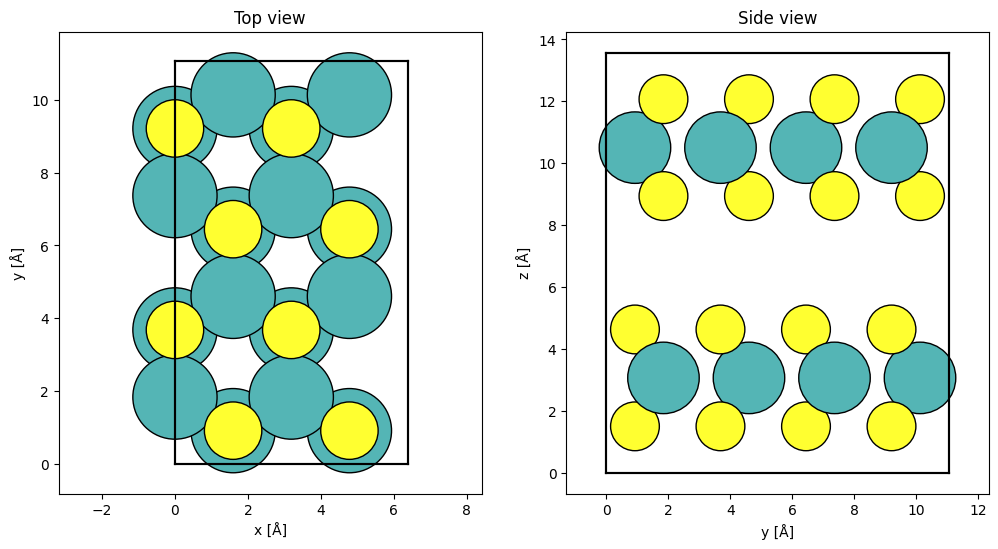

In [7]:
list_xyz = read(cif_file) # change to the file name

atoms_img = abtem.orthogonalize_cell(list_xyz, max_repetitions = 10,)#limit_denominator = 10, preserve_periodicity = True, return_strain = False)
atoms_img *= (2, 2, 1)
atoms_img.center(vacuum=1.5, axis=2)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,6))

abtem.show_atoms(atoms_img, ax=ax1, title='Top view')
abtem.show_atoms(atoms_img, ax=ax2, plane='yz', title='Side view')

In [12]:
potential = abtem.Potential(atoms_img,
                      gpts=512,
                      projection='finite',
                      slice_thickness=0.1,
                      parametrization='kirkland', device='cpu')#, storage='cpu')

potential = potential.build()

In [15]:

'''
This step is not necessary for getting a STEM image, however.

''';

# potential.project().show()  # ~3 minutes on colab CPU

In [16]:
potential.array.shape

(136, 512, 512)

## Simulate the probe
* Here we use 60kV
* semiangle of 20 mrad usually fine for most tasks (simulation time also increases with larger cutoff angles)
* defocus and spherical are about normal.
* There are options to add various aberrations and so on but let's leave the parameters as is

In [19]:
probe = abtem.Probe(energy=60e3, semiangle_cutoff=20, defocus=40, Cs=3e5, device='cpu')
probe.grid.match(potential)

print(f"defocus = {probe.aberrations.defocus} Å")
print(f"FWHM = {probe.profiles().width().compute()} Å")

defocus = 40 Å
FWHM = 1.2586792707443237 Å


[########################################] | 100% Completed | 230.75 ms
[########################################] | 100% Completed | 316.97 ms


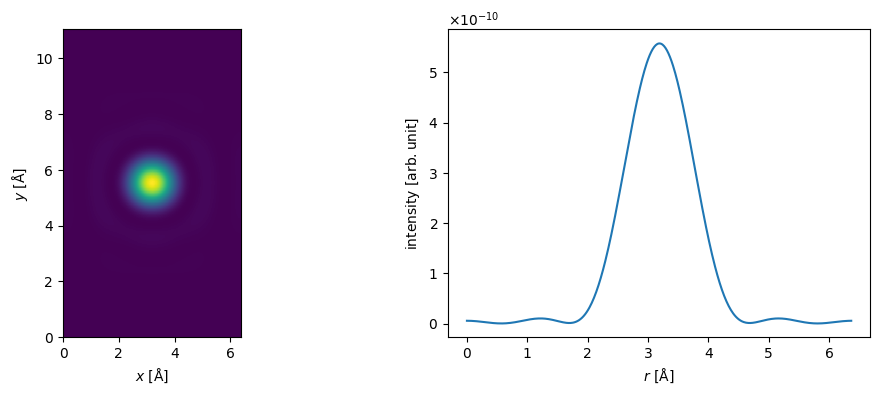

In [20]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
probe.show(ax=ax1)
probe.profiles().show(ax=ax2);

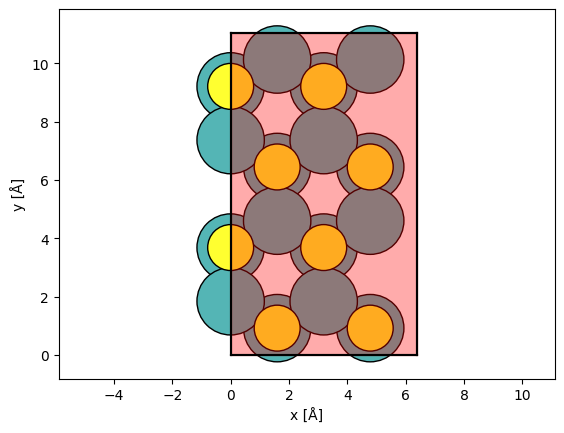

In [24]:
end = (potential.extent[0], potential.extent[1])
grid_scan = abtem.GridScan(start=[0, 0], end=end, sampling=probe.ctf.nyquist_sampling * .9)

fig, ax = abtem.show_atoms(atoms_img)

grid_scan.add_to_plot(ax)

## Simulate the scan

In [25]:
# ~3 minutes with GPU, or 7-8 min CPU

detector = abtem.FlexibleAnnularDetector()
flexible_measurement = probe.scan(potential, scan=grid_scan, detectors=detector)
flexible_measurement.compute()

[########################################] | 100% Completed | 468.10 s


The logic here is we will create a set of 2 HAADF images:

* one low dose image  (low quality)  --> used for the `image` itself
* one high dose image (high quality) --> used for creating `labels`

In [26]:
bf_measurement    = flexible_measurement.integrate_radial(0, probe.semiangle_cutoff)
maadf_measurement = flexible_measurement.integrate_radial(50, 150)
haadf_measurement = flexible_measurement.integrate_radial(80, 200)

In [27]:
measurements = abtem.stack(
    [bf_measurement, maadf_measurement, haadf_measurement], ("BF", "MAADF", "HAADF")
)

In [28]:
pxsize_ang = 0.2

In [ ]:
'''

high dose and low dose image

'''

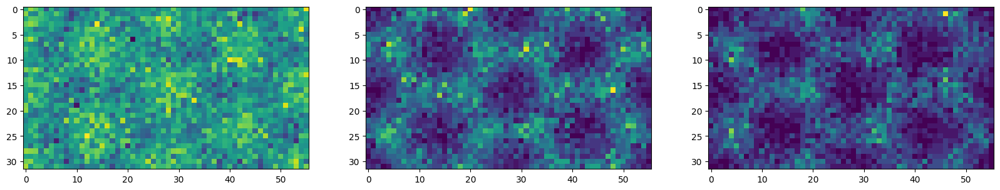

In [30]:
interpolated_measurements = measurements.interpolate(pxsize_ang)
filtered_measurements     = interpolated_measurements.gaussian_filter(0.3)
noisy_measurements        = filtered_measurements.poisson_noise(dose_per_area=1e4)

BAD_bf    = noisy_measurements[0].array
BAD_maadf = noisy_measurements[1].array
BAD_haadf = noisy_measurements[2].array

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,8))

ax1.imshow(BAD_bf)
ax2.imshow(BAD_maadf)
ax3.imshow(BAD_haadf)

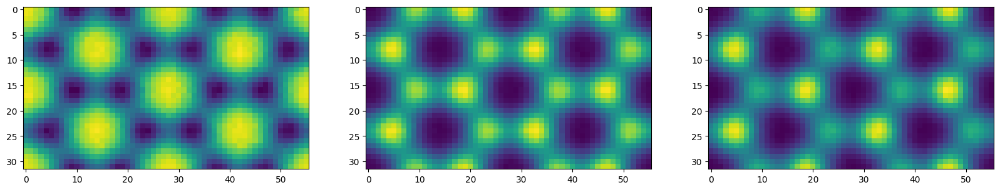

In [31]:
interpolated_measurements = measurements.interpolate(pxsize_ang)
filtered_measurements     = interpolated_measurements.gaussian_filter(0.3)
noisy_measurements        = filtered_measurements.poisson_noise(dose_per_area=1e7)

GOOD_bf    = noisy_measurements[0].array
GOOD_maadf = noisy_measurements[1].array
GOOD_haadf = noisy_measurements[2].array

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20,8))

ax1.imshow(GOOD_bf)
ax2.imshow(GOOD_maadf)
ax3.imshow(GOOD_haadf)

In [32]:
np.save("MoS2_SIM_HAADF-60kV-80-200_01_point_LOW DOSE.npy", BAD_haadf)
np.save("MoS2_SIM_HAADF-60kV-80-200_01_point_HIGH DOSE.npy", GOOD_haadf)

# Step 2: Prepare training data (simulated)

In [33]:
def make_image_square(image_2d):
    if not image_2d.ndim == 2:
        raise AssertionError("image must be 2D")

    d1,d2 = image_2d.shape
    if d1>d2:
        square_image = image_2d[:d2, :d2]
    else:
        square_image = image_2d[:d1, :d1]

    return square_image

def normalize(data):
    return (data - np.min(data))/np.ptp(data)

def rotate_points(origin, points, angle, limits = [0,512]):  # ARRAY OF POINTS
    ox, oy = origin
    points = points[:,:2]
    lowerlimit, upperlimit = limits[0], limits[1]

    rotated = np.zeros((points.shape[0], points.shape[1]))
    for ii in range(points.shape[0]):
        x, y = points[ii]
        qx = ox + np.cos(np.deg2rad(angle)) * (x - ox) + np.sin(np.deg2rad(angle)) * (y - oy)
        qy = oy + -np.sin(np.deg2rad(angle)) * (x - ox) + np.cos(np.deg2rad(angle)) * (y - oy)

        if (qx < lowerlimit) or (qy < lowerlimit) or (qx > upperlimit) or (qy > upperlimit):
            pass
        else:
            rotated[ii] = qx,qy

    return rotated

In [34]:
image_sim_bad  = np.load('MoS2_SIM_HAADF-60kV-80-200_01_point_LOW DOSE.npy')
image_sim_good = np.load('MoS2_SIM_HAADF-60kV-80-200_01_point_HIGH DOSE.npy')

## create labels

In [37]:
xtile = 20
ytile = 20

enlarged_bad = np.tile(image_sim_bad, (xtile,ytile))                   # tile it
training_image_large_bad = normalize(make_image_square(enlarged_bad))  # 1) Make it square and 2) normalize it [0,1]

enlarged_good = np.tile(image_sim_good, (xtile,ytile))                   # tile it
training_image_large_good = normalize(make_image_square(enlarged_good))  # 1) Make it square and 2) normalize it [0,1]

(640, 640)

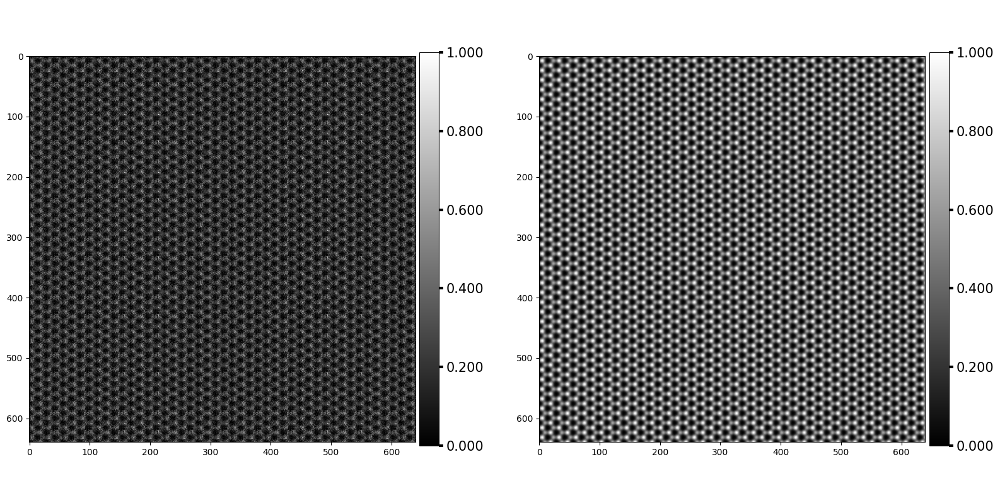

In [40]:
## Plotting

fig = plt.figure(figsize=(20,10))
gs = gridspec.GridSpec(1,4,width_ratios = [1,0.1,1,0.1])
ax1, cax1 = plt.subplot(gs[0]), plt.subplot(gs[1])
ax2, cax2 = plt.subplot(gs[2]), plt.subplot(gs[3])

img1 = ax1.imshow(training_image_large_bad, cmap = 'gray')
cbar1 = plt.colorbar(img1, ax=cax1, aspect = 20, fraction = 2, format="%0.3f", shrink = 0.81)
cbar1.ax.tick_params(labelsize = 15, width = 3, length = 5)
cax1.axis('off')

img2 = ax2.imshow(training_image_large_good, cmap = 'gray')
cbar2 = plt.colorbar(img2, ax=cax2, aspect = 20, fraction = 2, format="%0.3f", shrink = 0.81)
cbar2.ax.tick_params(labelsize = 15, width = 3, length = 5)
cax2.axis('off')


# plt.setp(ax, xticks=[], yticks=[]);

training_image_large_bad.shape

In [ ]:
'''

create labeled image

'''

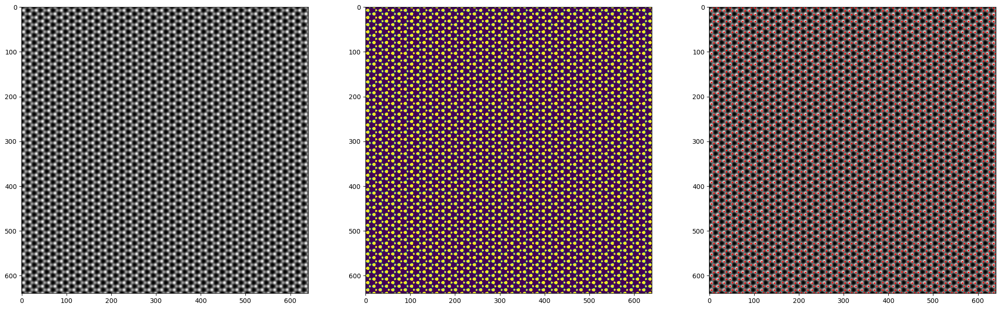

In [41]:
threshold = 0.5  # Adjust as needed. Create multiple thresholds if desire to start with more than one atom type
                 # but note that we will do augmentation steps later and this is where multiple atomic classes can enter the workflow if needed

training_label_large = np.copy(training_image_large_good)

training_label_large[np.where(training_label_large >= threshold)] = 1
training_label_large[np.where(training_label_large <  threshold)] = 0

f,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(27,9))
ax1.imshow(training_image_large_good, cmap = 'gray')
ax2.imshow(training_label_large)

##########################################################
##### Extract coordinates from the thresholded image #####
##########################################################

labels_, nlabels = ndimage.label(training_label_large)
coords_ = np.asarray(ndimage.center_of_mass(training_label_large, labels_, np.arange(nlabels) + 1))

###################################################
##### Assign a class label (0) to coordinates #####
###################################################
## Force a 3rd descriptor for class. Here all are just zero because single class

coords = np.concatenate( (coords_, np.zeros(len(coords_)).reshape(-1,1)), axis=1)
ax3.imshow(training_image_large_good, cmap = 'gray')
ax3.scatter(coords[:,1], coords[:,0], c='r', s=2)

In [ ]:
'''
Now we have a 1) large training image, 2) training labeled image, and 3) coordinates
We will chop this up a bunch, and perform data transformations on all the patches.
'''

In [45]:
# plt.imshow(training_image_large)

## capture rotations

In [54]:
angle_increment = 5

edge_removal    = 10
atom_size       = 5
gaussian_size   = 5

######################################
training_image_r = []
training_mask_r  = []
coords_r         = []

base_img = np.copy(training_image_large_bad)   # Now use the "bad" (more realstic) image
base_mask = np.copy(training_label_large)
classes  = coords[:,2]

num_classes     = len(np.unique(classes))

origin  = tuple(np.array(base_img.shape[1::-1]) / 2)

for a in range(0, 180, angle_increment):
    rotated_img = aoi.utils.cv_rotate(base_img, -a)
    training_image_r.append(rotated_img)

    rotated_coords = rotate_points(origin, coords, a, limits = [0, base_img.shape[0] - 10])
    rotated_coords = np.concatenate((rotated_coords, classes.reshape(-1,1)),axis=1)  # add back the class channel
    rotated_coords = aoi.utils.remove_edge_coord(rotated_coords, (base_img.shape[0], base_img.shape[1]), edge_removal)  # filter edge coords
    coords_r.append(rotated_coords)

    if num_classes > 1:
        training_mask_r.append(aoi.utils.create_multiclass_lattice_mask(rotated_img, rotated_coords, rmask=atom_size, scale = gaussian_size))
    else:
        training_mask_r.append(aoi.utils.create_lattice_mask(rotated_img, rotated_coords[:,:2], rmask=atom_size, scale = gaussian_size))

training_image_r = np.asarray(training_image_r)
training_mask_r  = np.asarray(training_mask_r)


In [52]:
coords_r[0]

array([[ 16.        ,  18.60869565,   0.        ],
       [ 15.97777778,  46.53333333,   0.        ],
       [ 16.        ,  74.60869565,   0.        ],
       ...,
       [624.11764706, 569.29411765,   0.        ],
       [623.88235294, 597.41176471,   0.        ],
       [624.11764706, 625.29411765,   0.        ]])

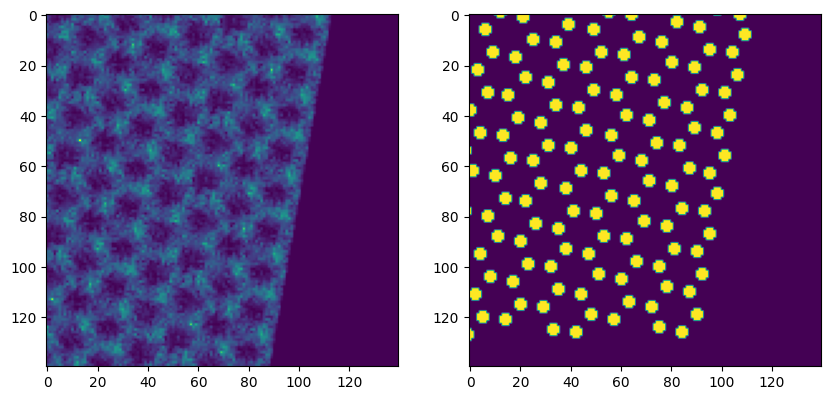

In [55]:
kk = 2

f,(ax1,ax2) = plt.subplots(1,2,figsize=(10,5))
ax1.imshow(training_image_r[kk][500:750,500:750])
ax2.imshow(training_mask_r[kk][500:750,500:750])

## create image-label pairs & apply transformations

In [62]:
num_ch      = 1
patchsize   = 64
num_patches = 40

image_patches_all, mask_patches_all = np.empty((0,patchsize,patchsize)), np.empty((0, patchsize, patchsize, num_ch))

print(f"This will produce {num_patches*len(training_mask_r)} total patches. Is it sufficient or too much?")

This will produce 1440 total patches. Is it sufficient or too much?


In [63]:
for s in range(len(training_image_r)):
    image_patches_, mask_patches_ = aoi.utils.extract_patches(
    training_image_r[s], training_mask_r[s], patch_size=patchsize, num_patches=num_patches)
    image_patches_all = np.append(image_patches_all, image_patches_)
    mask_patches_all  = np.append(mask_patches_all, mask_patches_)

image_patches_all = image_patches_all.reshape(-1,patchsize,patchsize)
mask_patches_all  = mask_patches_all.reshape(-1,patchsize,patchsize,num_classes)

In [64]:
dt = aoi.transforms.datatransform(n_channels=num_classes,
                                  contrast=[5,10],
                                  blur=[1,2],
                                  rotation=False,
                                  zoom = 1.1,
                                  poisson_noise = [35,45],
                                  salt_and_pepper = False,
                                  gauss_noise = [0,1])

image_patches_, mask_patches_ = dt.run(image_patches_all, mask_patches_all)

print(image_patches_.shape)
print(mask_patches_.shape)

(1440, 1, 64, 64)
(1440, 1, 64, 64)


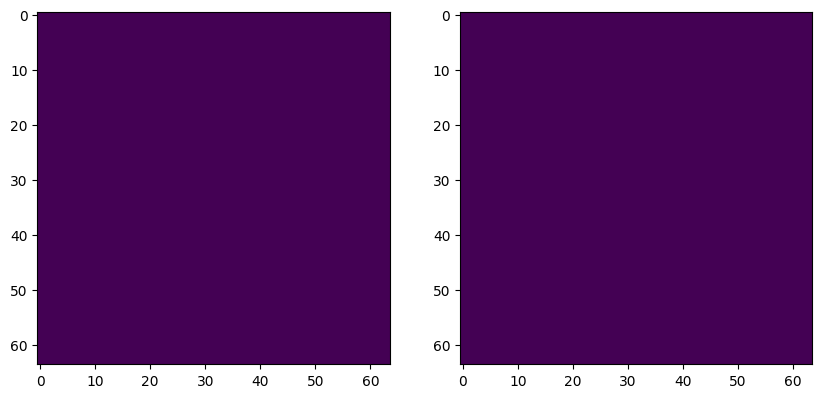

In [65]:
'''
some might be blank (due to rotation part)
need to be removed in a moment
'''

kk = 1111
f,(ax1,ax2) = plt.subplots(1,2,figsize=(10,5))
ax1.imshow(image_patches_all[kk])
ax2.imshow(mask_patches_all[kk])

In [68]:
image_patches_fixed, mask_patches_fixed = [], []
for kk in range(len(image_patches_)):
    if (np.isnan(image_patches_[kk,0].min()) == True) | (image_patches_[kk].max() == 0):
        pass
    else:
        image_patches_fixed.append(image_patches_[kk])
        mask_patches_fixed.append(mask_patches_[kk])

image_patches_fixed = np.asarray(image_patches_fixed)


image_patches = np.copy(image_patches_fixed)
for ii in range(len(image_patches_fixed)):
    image_patches[ii] = normalize(image_patches_fixed[ii])
mask_patches  = np.asarray(mask_patches_fixed)

print(mask_patches.shape)
print(image_patches.shape)

(1417, 1, 64, 64)
(1417, 1, 64, 64)


In [70]:
'''
if multiclass masks
'''
# if num_classes > 1:
#     mask_patches_sq = np.zeros(mask_patches.shape[:-1])
#     for c in range(mask_patches.shape[-1]):
#         mask_patches_sq += mask_patches[..., c] * c

'\nif multiclass masks\n'

In [71]:
np.save("mos2_01class_mask_patches_05.npy", mask_patches)
np.save("mos2_01class_image_patches_05.npy",image_patches)

# Step 3: Train ensemble v1

* Note: Be sure to <font color = 'crimson'><b>SAVE & DOWNLOAD</font> your image-mask patches
* Now that you've done that - it might help to switch to GPU (if you are not already on here)

In [72]:
'''

let's use only 2 models for the sake of time. But the idea is the same!

''';

In [73]:
model_name  = "mos2_MM2024_sim"
num_classes = 1
num_models  = 2



etrainer = aoi.trainers.EnsembleTrainer("Unet", nb_classes=num_classes, with_dilation=False,
                                        batch_norm=True)

etrainer.compile_ensemble_trainer(training_cycles=1000, compute_accuracy=True, swa=True, memory_alloc=0.5, filename=model_name)

smodel, ensemble = etrainer.train_ensemble_from_scratch(image_patches, mask_patches, n_models=num_models,layers=[2, 3, 3, 4])

Training ensemble models (strategy = 'from_scratch')

Ensemble model 1
Epoch 1/1000 ... Training loss: 0.963 ... Test loss: 0.6999 ... Train Accuracy: 0.278 ... Test Accuracy: 0.2069 ... GPU memory usage: N/A / N/A


KeyboardInterrupt: 

# Step 4: Predict on experimental


In [74]:

def plot_scalebar(axis, image, pixelsize_m, length_nm, dist_from_corner, **kwargs):

    ratio    = kwargs.get("ratio", 6)
    scalebar_style = kwargs.get("scalebar_style", "fixed") # fixed or percent
    sblength = length_nm/pixelsize_m
    sbheight = sblength/ratio
    d1,d2 = image.shape
    dist_from_corner = (dist_from_corner*d1)/100

    if scalebar_style == 'percent':
        sblength = (length_nm * d1)
        sbheight = sblength/ratio
        actual_length = sblength*pixelsize_m
    else:
        actual_length = length_nm
    o1,o2 = d2 - dist_from_corner - sblength, d1-dist_from_corner-sbheight
    axis.add_patch(patches.Rectangle((o1,o2),sblength, sbheight, color = 'w', ec='k'))
    # print(f"scalebar length: {actual_length} nm")

    return actual_length

In [79]:
!wget -O "mos2_images.zip" https://www.dropbox.com/scl/fo/xbuurjl35q9rnfbzy18qd/ADa4P2hVKv8fBeYTXbvqbAU?rlkey=6qmjc7vsz53igr3jk9xzgy5yy&dl=0
!unzip mos2_images.zip

--2024-07-28 05:48:55--  https://www.dropbox.com/scl/fo/xbuurjl35q9rnfbzy18qd/ADa4P2hVKv8fBeYTXbvqbAU?rlkey=6qmjc7vsz53igr3jk9xzgy5yy
Resolving www.dropbox.com (www.dropbox.com)... 162.125.5.18, 2620:100:601d:18::a27d:512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.5.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://ucd9c71f2fb399afb6b7287ca3f8.dl.dropboxusercontent.com/zip_download_get/B6-8A7Gv9xTol2IFmb4IcFWsDHjVY9HeLmSJxuzdnsPkXILl9rBhMI8H-Tnzy1JrFs2ztvWQ7v5RJNhiJnSHTSPp0B0Tvuke8_en_tMv-9ByZw# [following]
--2024-07-28 05:48:55--  https://ucd9c71f2fb399afb6b7287ca3f8.dl.dropboxusercontent.com/zip_download_get/B6-8A7Gv9xTol2IFmb4IcFWsDHjVY9HeLmSJxuzdnsPkXILl9rBhMI8H-Tnzy1JrFs2ztvWQ7v5RJNhiJnSHTSPp0B0Tvuke8_en_tMv-9ByZw
Resolving ucd9c71f2fb399afb6b7287ca3f8.dl.dropboxusercontent.com (ucd9c71f2fb399afb6b7287ca3f8.dl.dropboxusercontent.com)... 162.125.5.15, 2620:100:601d:15::a27d:50f
Connecting to ucd9c71f2fb399afb6b7287ca3f8.dl.dropbo

In [115]:
im_files

['SuperScan-a-8.ndata1',
 'SuperScan-a-12.ndata1',
 'SuperScan-a-13.ndata1',
 'SuperScan-a-1.ndata1',
 'SuperScan-a-11.ndata1',
 'SuperScan-a-10.ndata1']

In [81]:
images, meta = {}, {}

im_files = glob.glob("*Super*")

for ii,f in enumerate(im_files):
    images[ii] = np.load(f)['data']
    meta[ii] = json.loads(np.load(f)['metadata.json'])['spatial_calibrations'][0]['scale']
images.keys()

dict_keys([0, 1, 2, 3, 4, 5])

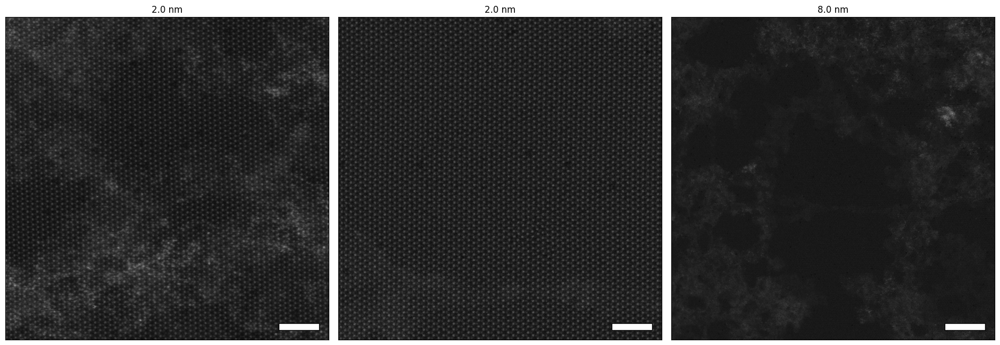

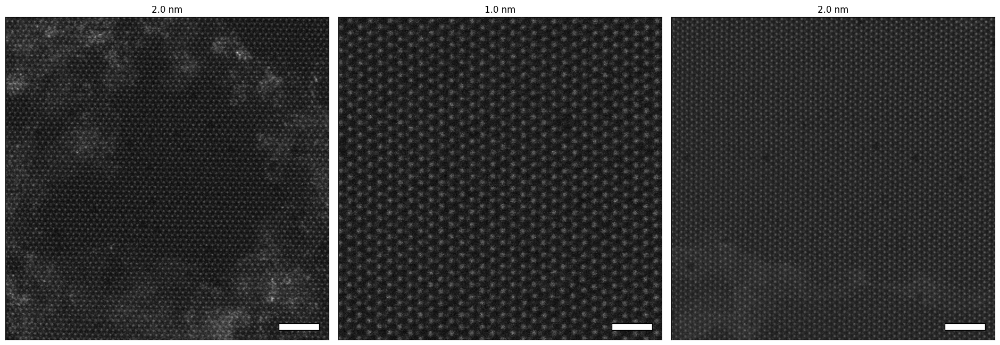

In [82]:
IMAGES, SCALES = images, meta

num_im = len(IMAGES)

ncols = 3
fsize = 8
scalebar_length_f = 0.125

gs = gridspec.GridSpec(1, ncols, wspace = 0.03, hspace = 0.01)

for kk in range(int(np.ceil(num_im/ncols))):
    fig = plt.figure(figsize=(fsize*ncols,fsize))
    for ii in range(ncols):
        try:
            image, scale = IMAGES[int(kk*ncols + ii)], SCALES[int(ncols*kk + ii)]
            ax = fig.add_subplot(gs[ii])
            ax.imshow(image, cmap = 'gray')
            FOV = scale*image.shape[0]
            plot_scalebar(ax, image, scale, scalebar_length_f*FOV, 3)
            ax.set_title(f'{scalebar_length_f*FOV} nm')
            plt.setp(ax,xticks=[],yticks=[])
        except KeyError:
            pass

In [89]:
# !wget -O "mos2_MM2024_sim_ensemble_metadict.tar" https://www.dropbox.com/scl/fi/n637i1v33ydis94o440f7/mos2_MM2024_SIM_ensemble_metadict.tar?rlkey=dnagwmlpk2rtzaji2t1wz387a&dl=0
# smodel, ensemble = aoi.models.load_ensemble(f"{model_name}_ensemble_metadict.tar")

In [ ]:
'''

check image #4

'''

8.0


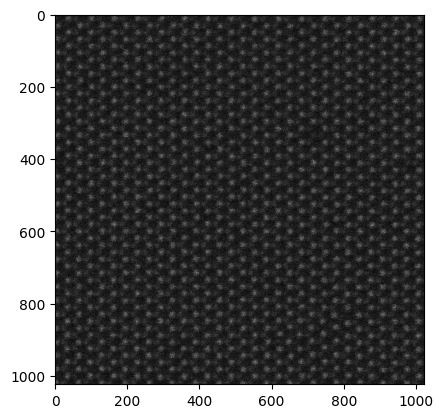

In [83]:
kk = 4

image, scale = IMAGES[kk], SCALES[kk]

FOV_nm = scale*image.shape[0]
print(FOV_nm)

plt.imshow(image, cmap = 'gray')

533
Batch 1/1
1 image was decoded in approximately 1.3122 seconds
1686 atoms found


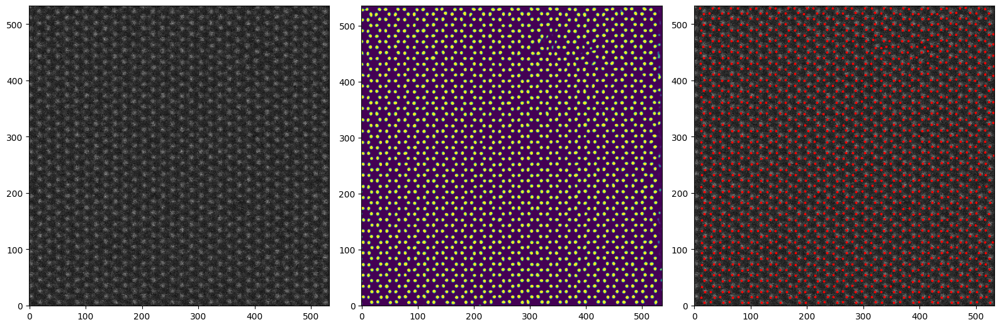

In [88]:
pxsize_nm       = 0.015
powerfactor = 1
model       = 0


resize_dim = int(FOV_nm/pxsize_nm)
imgdata_r = aoi.utils.cv_resize(image, (resize_dim, resize_dim))
imgdata = normalize((imgdata_r - imgdata_r.min())**powerfactor)


smodel.load_state_dict(ensemble[model])
decoded_imgs, coordinates = aoi.predictors.SegPredictor(smodel, use_gpu=False, norm = True).run(imgdata)

fig, axs = plt.subplots(1, 3, figsize=(16, 8))
axs[0].imshow(imgdata, cmap='gray', origin="lower")
axs[1].imshow(decoded_imgs[0,:,:,:], origin = 'lower')
axs[2].imshow(imgdata, cmap = 'gray', origin = 'lower')

axs[2].scatter(coordinates[0][:,1], coordinates[0][:,0], c = 'r',s=3)

plt.tight_layout()
print(f"{len(coordinates[0])} atoms found")

## Subclassify


GMM components


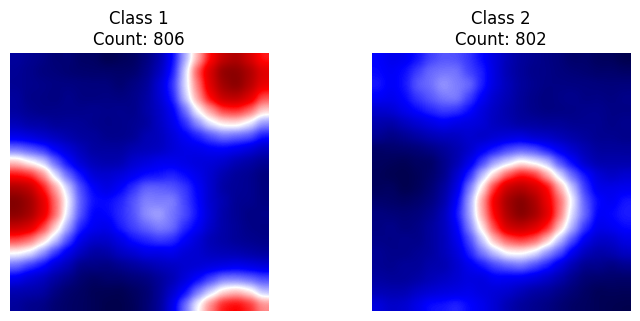

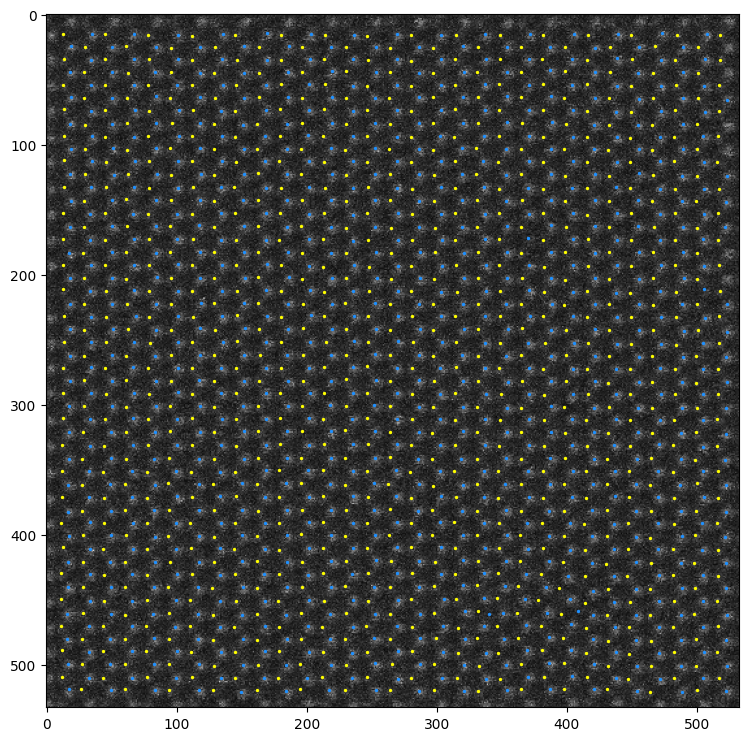

In [90]:
window_size_angstroms = 3
n_comps               = 2
window_size_px        = int(window_size_angstroms / pxsize_nm / 10)

##########################################################
##########################################################
######## Using gaussian mixture model (GMM) here #########
##########################################################
##########################################################
separation = aoi.stat.update_classes(coordinates, imgdata,
                                      method='gmm_local',
                                      n_components=n_comps,
                                      window_size=window_size_px,
                                      coord_class=0)
#                                       thresh = 0.5)

class0 = separation[0][np.where(separation[0][:,2] == 0)]
class1 = separation[0][np.where(separation[0][:,2] == 1)]

C0mean = np.mean(aoi.utils.get_intensities_(class0, imgdata, r=5))
C1mean = np.mean(aoi.utils.get_intensities_(class1, imgdata, r=5))

if C0mean > C1mean:
    Mo = class0
    S2 = class1
else:
    Mo = class1
    S2 = class0

plt.figure(figsize=(9,9))
plt.imshow(imgdata, cmap = 'gray')
plt.scatter(Mo[:,1], Mo[:,0], c='dodgerblue', s = 2)
plt.scatter(S2[:,1], S2[:,0], c='yellow',     s = 2)

In [91]:
'''

Wrap the splitter into a single function, for use on all the images!

'''

def MoS2_coord_splitter(image,
                        FOV_nm, pxsize_nm_prediction, smodel, ensemble,
                        powerfactor = 0.9, model = 0,
                        window_size_angstroms = 3, show_GMM = True):

    ##########################
    ### initial prediction ###
    ##########################
    resize_dim = int(FOV_nm/pxsize_nm_prediction)
    imgdata_r = aoi.utils.cv_resize(image, (resize_dim, resize_dim))
    imgdata = normalize((imgdata_r - imgdata_r.min())**powerfactor)

    smodel.load_state_dict(ensemble[model])
    decoded_imgs, coordinates = aoi.predictors.SegPredictor(smodel, use_gpu=False, norm = True).run(imgdata)

    fig, axs = plt.subplots(1, 3, figsize=(16, 8))
    axs[0].imshow(imgdata, cmap='gray', origin="lower")
    axs[1].imshow(decoded_imgs[0,:,:,:], origin = 'lower')
    axs[2].imshow(imgdata, cmap = 'gray', origin = 'lower')
    axs[2].scatter(coordinates[0][:,1], coordinates[0][:,0], c = 'r',s=3)
    plt.tight_layout()
    print(f"{len(coordinates[0])} atoms found")



    ##########################
    ### Sub classification ###
    ##########################
    num_comps             = 2          # keeping 2 for this current workflow
    window_size_px        = int(window_size_angstroms / pxsize_nm_prediction / 10)

    separation = aoi.stat.update_classes(coordinates, imgdata,
                                      method='gmm_local',
                                      n_components=num_comps,
                                      window_size=window_size_px,
                                      coord_class=0)
#                                       thresh = 0.5)

    class0 = separation[0][np.where(separation[0][:,2] == 0)]
    class1 = separation[0][np.where(separation[0][:,2] == 1)]

    C0mean = np.mean(aoi.utils.get_intensities_(class0, imgdata, r=5))
    C1mean = np.mean(aoi.utils.get_intensities_(class1, imgdata, r=5))

    if C0mean > C1mean:
        Mo = class0
        S2 = class1
    else:
        Mo = class1
        S2 = class0


    if show_GMM:

        GMM_            = aoi.stat.imlocal(imgdata, coordinates, window_size = window_size_px)
        _,GMM_results,_ = GMM_.gmm(num_comps, covariance = 'diag', random_state = 1)
        GMM_means       = np.zeros((len(GMM_results), window_size_px, window_size_px))
        GMM_lengths = []

        for mm,stack in enumerate(GMM_results):
            GMM_lengths.append(len(stack))
            GMM_means[mm] = np.mean(stack.squeeze(),axis=0)

        rows = int(np.ceil(float(num_comps)/3))
        cols = int(np.ceil(float(num_comps)/rows))

        gs1 = gridspec.GridSpec(rows, cols, hspace = 0.5)
        fig1 = plt.figure(figsize = (4*cols, 3.5*(1+rows)//1.5))
        for i in range(num_comps):
            ax1 = fig1.add_subplot(gs1[i])
            ax1.imshow(GMM_means[i], cmap = 'seismic')
            ax1.set_title('Component ' + str(i + 1) + f'\n {GMM_lengths[i]} found')
            plt.setp(ax1,xticks=[],yticks=[])


    plt.figure(figsize=(9,9))
    plt.imshow(imgdata, cmap = 'gray')
    plt.scatter(Mo[:,1], Mo[:,0], c='dodgerblue', s = 2)
    plt.scatter(S2[:,1], S2[:,0], c='yellow',     s = 2)

    # For consistency, let's label Mo == 0 and S2 == 1
    # we will use this convention when aggregating all coordinates
    Mo[:,2] = 0
    S2[:,2] = 1

    joined = np.concatenate((Mo, S2), axis=0)

    return joined, imgdata

## Collect more!

In [92]:
coords_mos2_all = {}  # initialize coordinate array
image_mos2_all  = {}

Batch 1/1
1 image was decoded in approximately 7.7509 seconds
7109 atoms found

GMM components


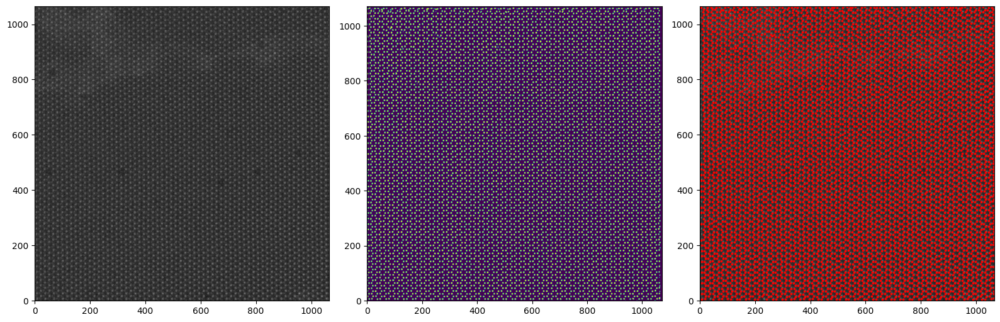

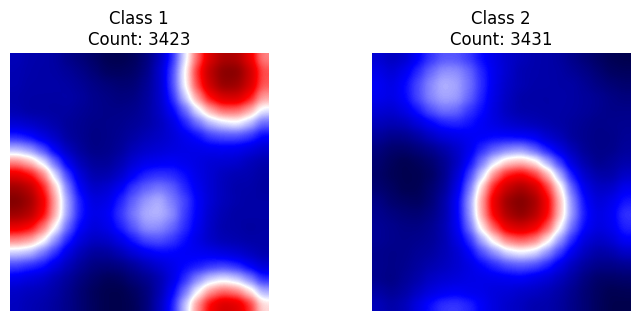

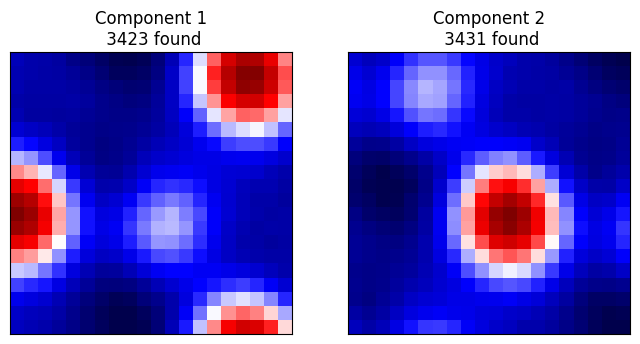

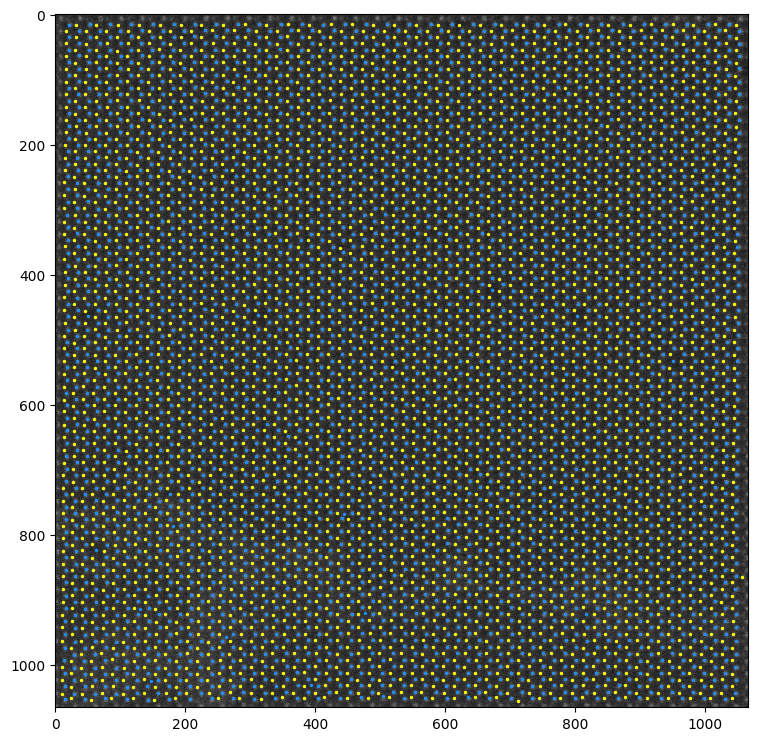

In [94]:
kk = 5

'''
fine tune until good prediction (probably not much needed!)
'''
FOV_nm                = IMAGES[kk].shape[0]* SCALES[kk]
pxsize_nm_prediction  = 0.015
model_number          = 0
powerfactor           = 1
window_size_angstroms = 3

coords_mos2_all[kk], image_mos2_all[kk]  = MoS2_coord_splitter(IMAGES[kk], FOV_nm, pxsize_nm_prediction, smodel, ensemble,
                                                               powerfactor = powerfactor, model = model_number,
                                                               window_size_angstroms = window_size_angstroms,
                                                              show_GMM = True)

Batch 1/1
1 image was decoded in approximately 5.5925 seconds
8081 atoms found

GMM components


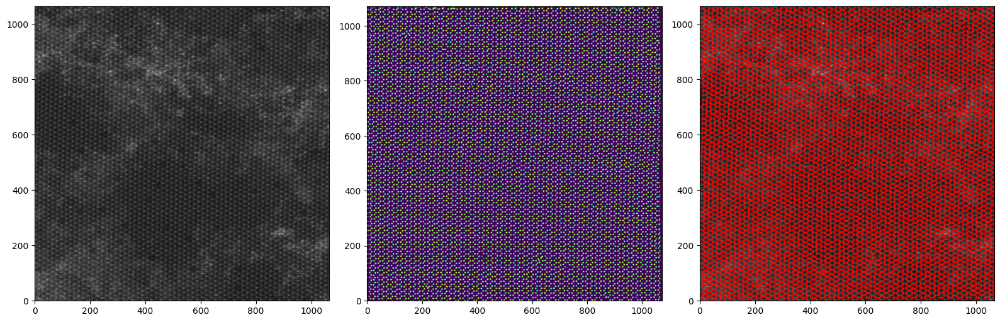

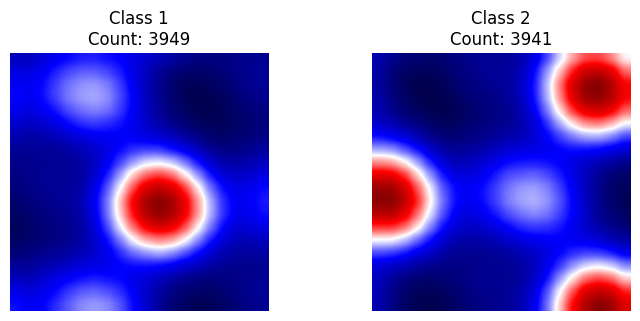

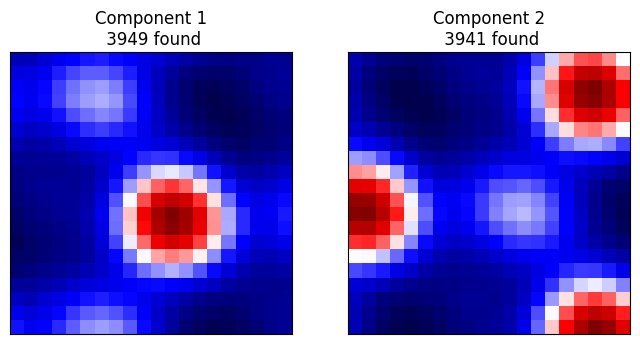

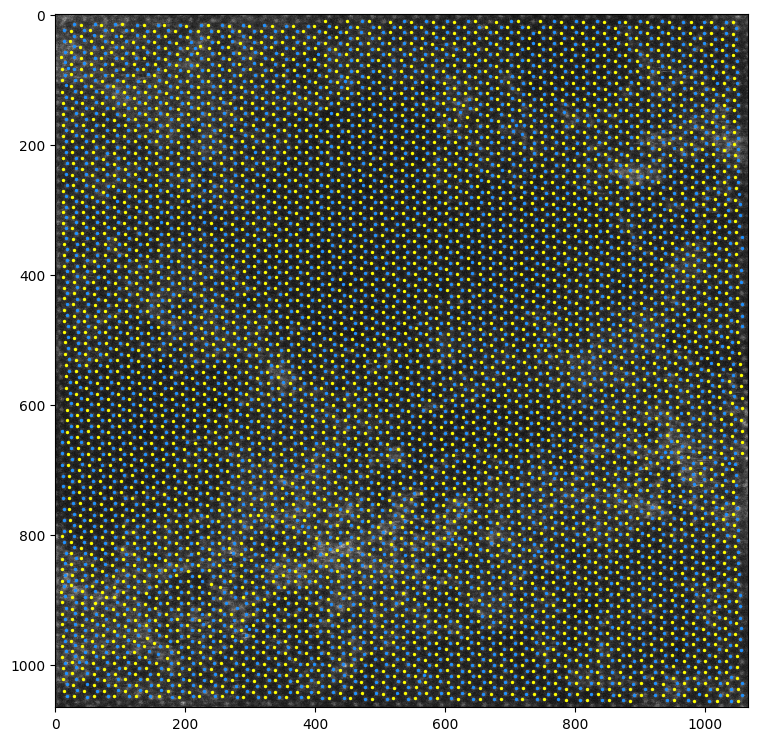

In [97]:
kk = 0

'''
fine tune until good prediction (probably not much needed!)
'''
FOV_nm                = IMAGES[kk].shape[0]* SCALES[kk]
pxsize_nm_prediction  = 0.015
model_number          = 0
powerfactor           = 1
window_size_angstroms = 3

coords_mos2_all[kk], image_mos2_all[kk]  = MoS2_coord_splitter(IMAGES[kk], FOV_nm, pxsize_nm_prediction, smodel, ensemble,
                                                               powerfactor = powerfactor, model = model_number,
                                                               window_size_angstroms = window_size_angstroms,
                                                              show_GMM = True)

Batch 1/1
1 image was decoded in approximately 6.0297 seconds
7511 atoms found

GMM components


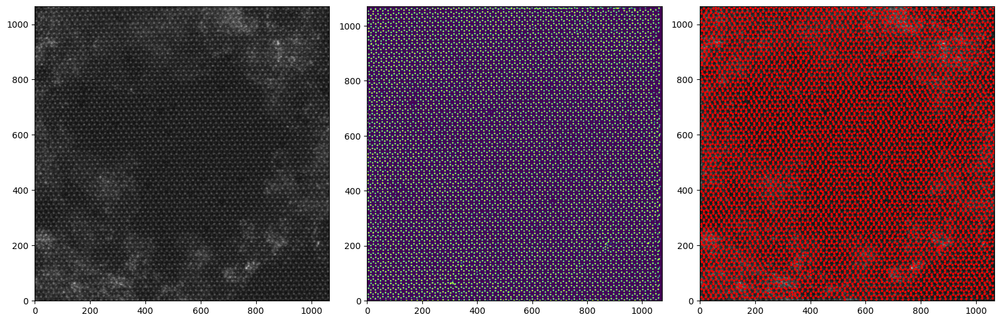

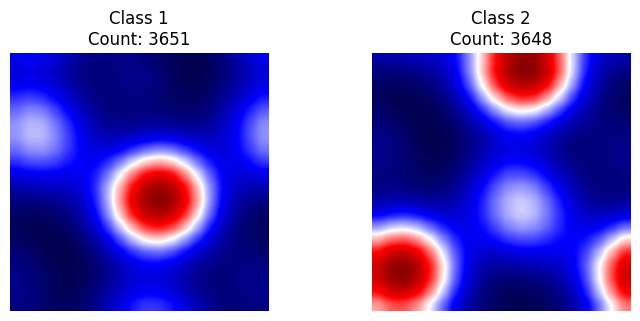

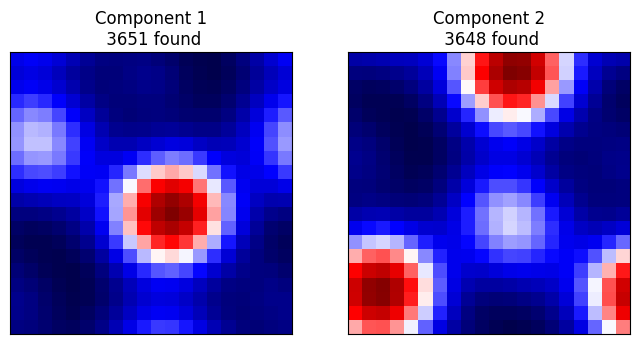

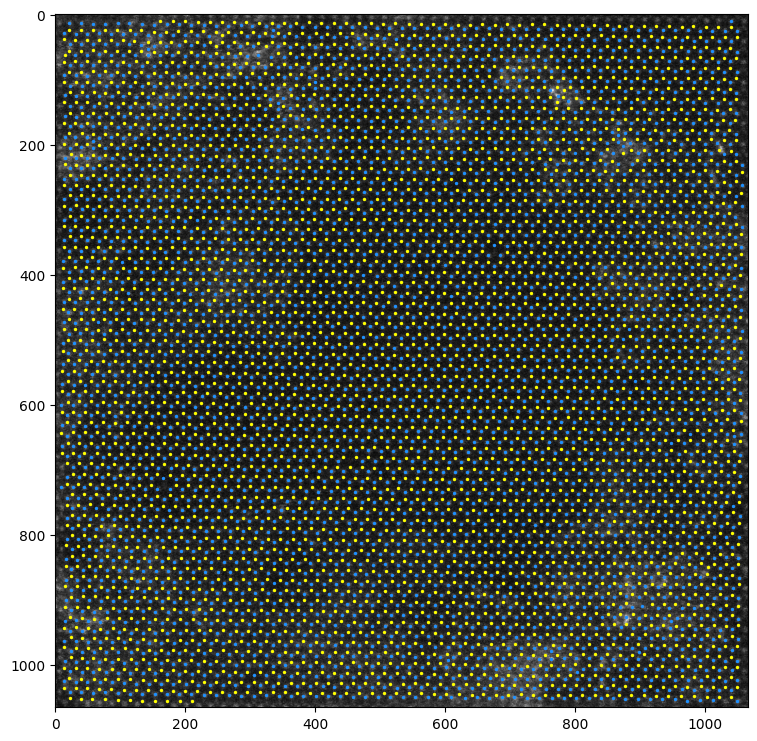

In [96]:
kk = 3

'''
fine tune until good prediction (probably not much needed!)
'''
FOV_nm                = IMAGES[kk].shape[0]* SCALES[kk]
pxsize_nm_prediction  = 0.015
model_number          = 0
powerfactor           = 1
window_size_angstroms = 3

coords_mos2_all[kk], image_mos2_all[kk]  = MoS2_coord_splitter(IMAGES[kk], FOV_nm, pxsize_nm_prediction, smodel, ensemble,
                                                               powerfactor = powerfactor, model = model_number,
                                                               window_size_angstroms = window_size_angstroms)

# Step 5: Build new ensemble!
* Augment with this (now labeled) data!
* We create a NEW training set from this new labeled (EXPERIMENTAL) data, to generalize more to other real conditions (noise, contrast, etc)

In [103]:
# Can take a few minutes

angle_increment = 10

training_image_r_ALL = {}
training_mask_r_ALL  = {}
coords_r_all         = {}


for kk, val in image_mos2_all.items():

    base_img        = np.copy(image_mos2_all[kk])
    classes         = coords_mos2_all[kk][:,2]
    num_classes     = len(np.unique(classes))

    training_image_r = []
    training_mask_r  = []
    coords_r = []

    origin  = tuple(np.array(base_img.shape[1::-1]) / 2)

    for a in range(0, 180, angle_increment):
        rotated_img    = aoi.utils.cv_rotate(base_img, -a)
        training_image_r.append(rotated_img)

        rotated_coords = rotate_points(origin, coords_mos2_all[kk], a, limits = [0, base_img.shape[0] - 10])
        rotated_coords = np.concatenate((rotated_coords, classes.reshape(-1,1)),axis=1)  # add back the class channel
        rotated_coords = aoi.utils.remove_edge_coord(rotated_coords, (base_img.shape[0], base_img.shape[1]), edge_removal)  # filter edge coords
        coords_r.append(rotated_coords)

        if num_classes > 1:
            training_mask_r.append(aoi.utils.create_multiclass_lattice_mask(rotated_img, rotated_coords, rmask=atom_size, scale = gaussian_size))
        else:
            training_mask_r.append(aoi.utils.create_lattice_mask(rotated_img, rotated_coords[:,:2], rmask=atom_size, scale = gaussian_size))

    training_image_r_ALL[kk] = np.asarray(training_image_r)
    training_mask_r_ALL[kk]  = np.asarray(training_mask_r)
    coords_r_all[kk]         = coords_r


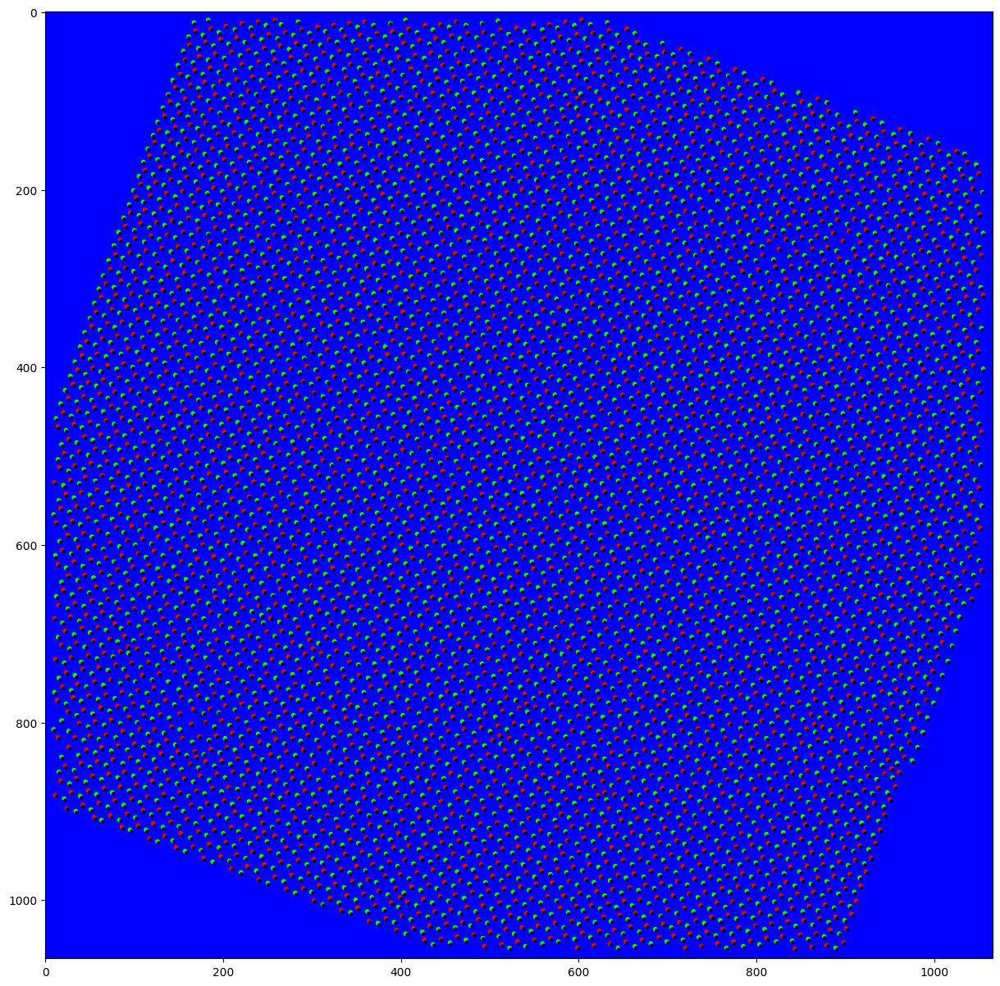

In [104]:
mm = 2

plt.figure(figsize=(15,15))
plt.imshow(training_mask_r[mm].squeeze())
plt.scatter(coords_r[mm][:,1], coords_r[mm][:,0], c='k', s=5)

# training_mask_r.shape

In [109]:
num_ch      = 3
patchsize   = 64
num_patches = 32

image_patches_all, mask_patches_all = np.empty((0,patchsize,patchsize)), np.empty((0, patchsize, patchsize, num_ch))

print(f"This will produce {num_patches*len(training_mask_r_ALL)*training_image_r_ALL[kk].shape[0]} total patches. Is it sufficient or too much?")

This will produce 1728 total patches. Is it sufficient or too much?


In [110]:
mask_patches_all = np.zeros((0,patchsize,patchsize))
image_patches_all = np.zeros((0,patchsize,patchsize))

for key,v in training_image_r_ALL.items():

    for ii in range(len(training_image_r_ALL[key])):
        image_patches_, mask_patches_ = aoi.utils.extract_patches(
        training_image_r_ALL[key][ii], training_mask_r_ALL[key][ii], patch_size=patchsize, num_patches=num_patches)


        mask_patches_sq = np.zeros(mask_patches_.shape[:-1])
        for c in range(mask_patches_.shape[-1]):
            mask_patches_sq += mask_patches_[..., c] * c

        image_patches_all = np.append(image_patches_all, image_patches_,axis = 0)
        mask_patches_all = np.append(mask_patches_all, mask_patches_sq, axis = 0)

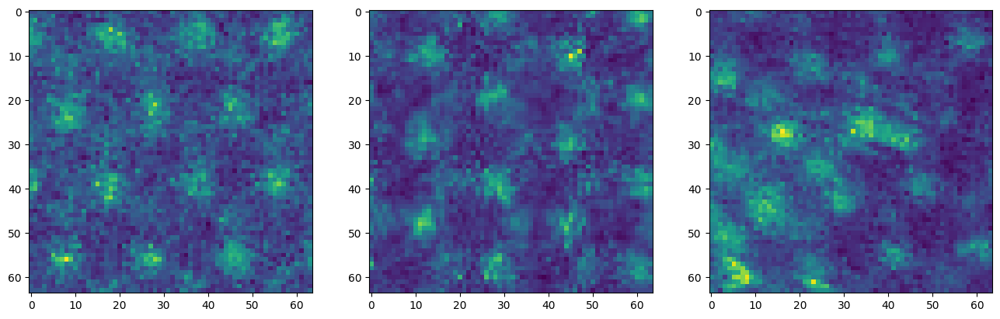

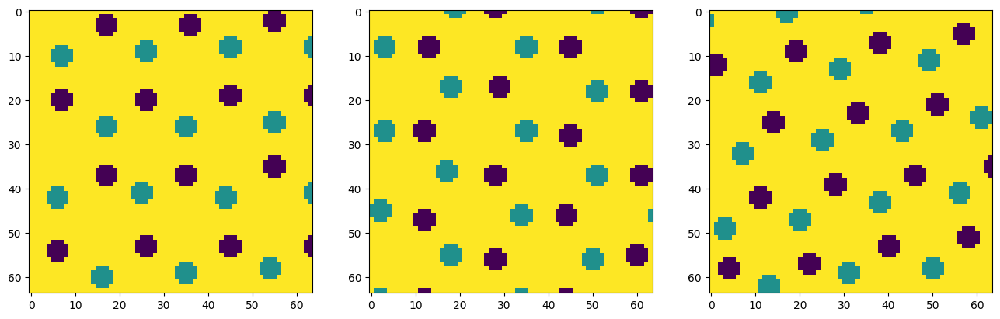

In [111]:
fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(16,6))
ax1.imshow(image_patches_all[122])
ax2.imshow(image_patches_all[888])
ax3.imshow(image_patches_all[1222])

fig,(ax1,ax2,ax3) = plt.subplots(1,3,figsize=(16,6))
ax1.imshow(mask_patches_all[122])
ax2.imshow(mask_patches_all[888])
ax3.imshow(mask_patches_all[1222])

In [112]:
'''

We don't need to reeeeeally add much here as we already have experimental images
however at the very least, varying the zoom factor in order to slightly broaden pixel size range may help

'''

dt = aoi.transforms.datatransform(n_channels=3, contrast=[5,10], blur=[1,10], rotation=False, zoom = 1.3)   # resize only works for INCREASING I guess (but can screw things up with interpolations), and zoom works for zooming IN ( by cropping )
image_patches_, mask_patches_ = dt.run(image_patches_all, mask_patches_all)

mask_patches_.shape


(1728, 64, 64)

In [113]:
'''
again fix any NaN or blank patches
'''

image_patches_fixed, mask_patches_fixed = [], []
for kk in range(len(image_patches_)):
    if (np.isnan(image_patches_[kk,0].min()) == True) | (image_patches_[kk].max() == 0):
        pass
    else:
        image_patches_fixed.append(image_patches_[kk])
        mask_patches_fixed.append(mask_patches_[kk])

image_patches_fixed = np.asarray(image_patches_fixed)


image_patches = np.copy(image_patches_fixed)
for ii in range(len(image_patches_fixed)):
    image_patches[ii] = normalize(image_patches_fixed[ii])

mask_patches  = np.asarray(mask_patches_fixed)

print(mask_patches.shape)
print(image_patches.shape)

(1698, 64, 64)
(1698, 1, 64, 64)


In [ ]:
np.unique(mask_patches)

array([0., 1., 2.])

In [114]:
np.save("mos2_02class_mask_patches_EXPERIMENTAL-01.npy", mask_patches)
np.save("mos2_01class_image_patches_EXPERIMENTAL-01.npy", image_patches)

## Train final

Training ensemble models (strategy = 'from_scratch')

Ensemble model 1
Epoch 1/1000 ... Training loss: 1.4615 ... Test loss: 1.1349 ... Train Accuracy: 0.1227 ... Test Accuracy: 0.0213 ... GPU memory usage: 1146/4096
Epoch 100/1000 ... Training loss: 0.4824 ... Test loss: 0.4692 ... Train Accuracy: 0.6177 ... Test Accuracy: 0.5846 ... GPU memory usage: 1150/4096
Epoch 200/1000 ... Training loss: 0.2019 ... Test loss: 0.2143 ... Train Accuracy: 0.7407 ... Test Accuracy: 0.7194 ... GPU memory usage: 1150/4096
Epoch 300/1000 ... Training loss: 0.1333 ... Test loss: 0.1667 ... Train Accuracy: 0.7845 ... Test Accuracy: 0.7377 ... GPU memory usage: 1150/4096
Epoch 400/1000 ... Training loss: 0.103 ... Test loss: 0.1426 ... Train Accuracy: 0.8168 ... Test Accuracy: 0.7727 ... GPU memory usage: 1150/4096
Epoch 500/1000 ... Training loss: 0.0843 ... Test loss: 0.1352 ... Train Accuracy: 0.8485 ... Test Accuracy: 0.7845 ... GPU memory usage: 1150/4096
Epoch 600/1000 ... Training loss: 0.07 ... T

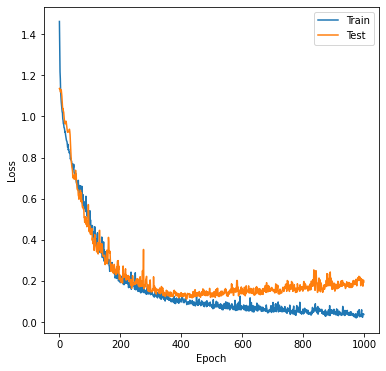


Ensemble model 2
Epoch 1/1000 ... Training loss: 1.4768 ... Test loss: 1.1163 ... Train Accuracy: 0.0876 ... Test Accuracy: 0.0228 ... GPU memory usage: 1142/4096
Epoch 100/1000 ... Training loss: 0.5633 ... Test loss: 0.5114 ... Train Accuracy: 0.5802 ... Test Accuracy: 0.5927 ... GPU memory usage: 1162/4096
Epoch 200/1000 ... Training loss: 0.2032 ... Test loss: 0.2323 ... Train Accuracy: 0.744 ... Test Accuracy: 0.6867 ... GPU memory usage: 1162/4096
Epoch 300/1000 ... Training loss: 0.1409 ... Test loss: 0.1586 ... Train Accuracy: 0.7731 ... Test Accuracy: 0.7656 ... GPU memory usage: 1162/4096
Epoch 400/1000 ... Training loss: 0.1037 ... Test loss: 0.1482 ... Train Accuracy: 0.8112 ... Test Accuracy: 0.7529 ... GPU memory usage: 1162/4096
Epoch 500/1000 ... Training loss: 0.0769 ... Test loss: 0.1341 ... Train Accuracy: 0.8544 ... Test Accuracy: 0.7807 ... GPU memory usage: 1162/4096
Epoch 600/1000 ... Training loss: 0.0631 ... Test loss: 0.1469 ... Train Accuracy: 0.877 ... Test

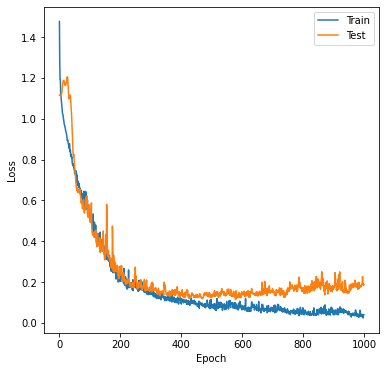

In [ ]:
num_classes = 3
n_models    = 2
model_name = 'mos2-MM2024-experimental'



etrainer = aoi.trainers.EnsembleTrainer("Unet", nb_classes=num_classes, with_dilation=False,
                                        batch_norm=True)

etrainer.compile_ensemble_trainer(training_cycles=1000, compute_accuracy=True, swa=True, memory_alloc=0.5, filename = model_name)

smodel, ensemble = etrainer.train_ensemble_from_scratch(image_patches, mask_patches, n_models=2, layers=[2, 3, 3, 4])

In [108]:
# model_name

# Step 6: Redeploy

In [116]:
!wget -O "new_exp_image.ndata1" https://www.dropbox.com/scl/fi/oxiaq6w8jzkm1tqbxte3i/new-flake-far-away-SuperScan-a-9.ndata1?rlkey=jgcrth5ywmsze86w9uyc1uguv&dl=0

--2024-07-28 06:12:38--  https://www.dropbox.com/scl/fi/oxiaq6w8jzkm1tqbxte3i/new-flake-far-away-SuperScan-a-9.ndata1?rlkey=jgcrth5ywmsze86w9uyc1uguv
Resolving www.dropbox.com (www.dropbox.com)... 162.125.5.18, 2620:100:601d:18::a27d:512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.5.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://uc06b710217fcb751e0ba719df3d.dl.dropboxusercontent.com/cd/0/inline/CXgV7lbsIE_VgjAKUgsKN_9FS3TMQRi67LqFI9qknih2VsqKj3B_E7YuiVzaZ26lOU_XW0jJYmyDVX2GRgv-Q9b5nZ9FZyLpNQplNz8BgwK7sNMZcwNh26Hd-ZQ9xAOSHPYcFMJ7m6qzpDnOu1rDTqdD/file# [following]
--2024-07-28 06:12:39--  https://uc06b710217fcb751e0ba719df3d.dl.dropboxusercontent.com/cd/0/inline/CXgV7lbsIE_VgjAKUgsKN_9FS3TMQRi67LqFI9qknih2VsqKj3B_E7YuiVzaZ26lOU_XW0jJYmyDVX2GRgv-Q9b5nZ9FZyLpNQplNz8BgwK7sNMZcwNh26Hd-ZQ9xAOSHPYcFMJ7m6qzpDnOu1rDTqdD/file
Resolving uc06b710217fcb751e0ba719df3d.dl.dropboxusercontent.com (uc06b710217fcb751e0ba719df3d.dl.dropboxusercontent.c

In [ ]:
model_name

In [117]:
filename = "new_exp_image.ndata1"
img_new   = np.load(f)['data']
FOV_nm_new = json.loads(np.load(f)['metadata.json'])['spatial_calibrations'][0]['scale'] * img_new.shape[0]


In [ ]:
smodel_new, ensemble_new = aoi.models.load_ensemble(f"{model_name}_ensemble_metadict.tar")

32.0

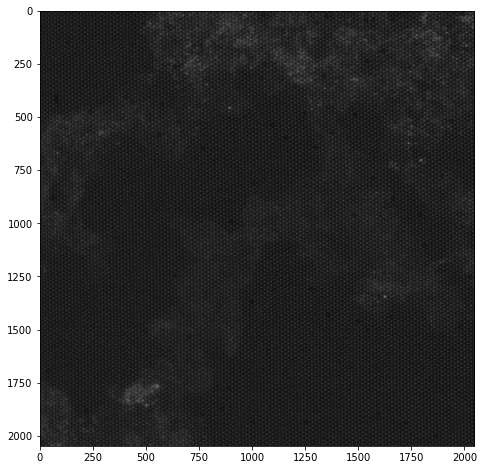

In [ ]:
'''
test with experimental data that the model hasn't seen!
'''

test_img     = np.copy(img_new )
test_FOV_nm  = FOV_nm_new

plt.figure(figsize=(8,8))
plt.imshow(test_img, cmap = 'gray')
test_FOV_nm

2133
Batch 1/1
1 image was decoded in approximately 3.7381 seconds
28066 atoms found


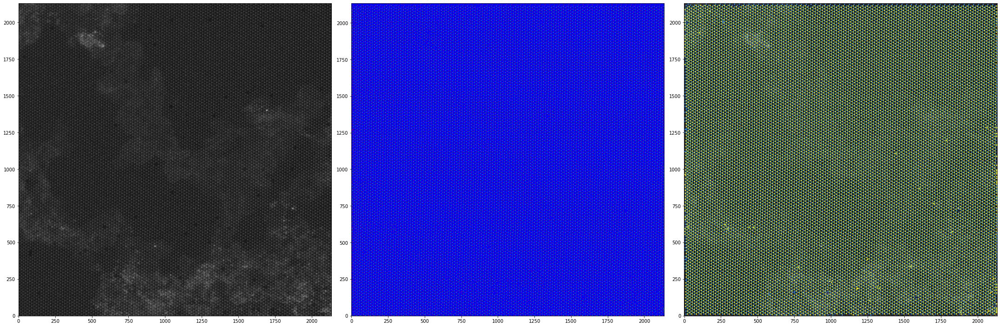

In [ ]:
image = np.copy(test_img)
image


pxsize_nm   = 0.015
powerfactor = 1
model       = 1


resize_dim = int(test_FOV_nm/pxsize_nm)
imgdata_r = aoi.utils.cv_resize(image, (resize_dim, resize_dim))
imgdata = normalize((imgdata_r - imgdata_r.min())**powerfactor)

print(resize_dim)

smodel_new.load_state_dict(ensemble_new[model])
decoded_imgs, coordinates = aoi.predictors.SegPredictor(smodel_new, use_gpu=False, norm = True).run(imgdata)

fig, axs = plt.subplots(1, 3, figsize=(30, 10))
axs[0].imshow(imgdata, cmap='gray', origin="lower")
axs[1].imshow(decoded_imgs[0,:,:,:], origin = 'lower')
axs[2].imshow(imgdata, cmap = 'gray', origin = 'lower')

mapped_colors = np.vectorize(colorkey_num.get)(coordinates[0][:,2])
mapped_sizes = np.vectorize(sizekey_num.get)(coordinates[0][:,2])
axs[2].scatter(coordinates[0][:,1], coordinates[0][:,0], c = mapped_colors,s=3)

plt.tight_layout()
print(f"{len(coordinates[0])} atoms found")